# Прокрустово преобразование

### Условие задачи

**Дано:**

- 5 датасетов: `tiny`, `small`, `medium`, `large`, `xlarge`
- каждый датасет содержит массив фигур (кривых) в трехмерном пространстве, а каждая фигура состоит из 1000 точек
- [прокрустово преобразование](https://en.wikipedia.org/wiki/Orthogonal_Procrustes_problem)
- метод главных компонент [`PCA`](https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html)
- метод [кластеризации](https://scikit-learn.org/stable/modules/clustering.html), например, [`k-средних`](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.k_means.html)

**Требуется:**

- выполнить описанные ниже требования для каждого датасета:
- для каждой пары фигур выполнить прокрустово преобразование и вычислить расстояние между кривыми
    - расстояние между кривыми = среднее евклидово расстояние между соответствующими точками фигур (т.е. точками с одинаковыми индексами)
- во время выполнения расчетов выводить время, затраченное на них
- построить матрицу расстояний между кривыми, где в i-й строке (и столбце) расположен вектор расстояний от i-й кривой до всех остальных
- отобразить матрицу расстояний на рисунке (график 0)
- к матрице расстояний применить метод главных компонент (`PCA`):
    - выделить 2 главных направления (компоненты), метод `fit`
    - спроецировать векторы расстояний на плоскость, заданную найденными направлениями, метод `transform`
    - на выходе будут получена матрица из двумерных векторов (`проекция`)
    - методы класса `PCA`: `fit` + `transform` или `fit_transform`
- полученную `проекцию` отобразить на рисунке (график 1)
- по графику 1 определить количество кластеров (визуально), если это требует выбранный метод кластеризации
- применить метод кластеризации к векторам `проекции`:
    - определить номер кластера для каждого вектора `проекции`, а, следовательно, для каждой фигуры
    - определить центры кластеров
- отобразить `проекцию`, центры и номера кластеров (график 2)
- для каждого кластера построить рисунок (графики 3):
    - три проекции фигур этого кластера (`x-y`, `x-z`, `y-z`)
    - фигуры отображать полупрозрачным цветом
    - см. Рис. 1
- задокументировать функции


**Материалы:**
- [Прокрустов анализ](https://en.wikipedia.org/wiki/Procrustes_analysis)
- [Прокрустово преобразование](https://en.wikipedia.org/wiki/Orthogonal_Procrustes_problem)
- [Метод главных компонент](https://ru.wikipedia.org/wiki/Метод_главных_компонент)
- [Методы кластеризации](https://scikit-learn.org/stable/modules/clustering.html)
- [Метод k-средних](https://ru.wikipedia.org/wiki/Метод_k-средних)


**Правила оценивания:**

- оценка за корректно выполненный расчет для каждого датасета, баллов из 100:
```
    dataset    =  tiny, small, medium, large, xlarge
    g(dataset) =   1.0,   6.2,   14.6,  28.2,   50.0
```

- штрафы $p(i)$, баллов:
    - не выведено время расчета - 20
    - не построен график 0 - 20
    - не построен график 1 - 20
    - не построен график 2 - 20
    - не построен график 3 - 30
    - нет документации функций - 20
    - менее значимые недоработки - 10


- итоговая оценка за задание = $\sum_{dataset=tiny}^{xlarge}{g(dataset)} - \sum_{i}{p(i)}$


In [1]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import numba as nb

import glob

from sklearn.decomposition import PCA
from sklearn.cluster import DBSCAN
from time import perf_counter
from contextlib import contextmanager

In [2]:
base_path = '/Users/rmnigm/Educational/jupyter_notebooks/python-cp3/hw-2/procrustes/'

In [3]:
paths = list(glob.glob(base_path + '*.npy'))
dset_names = [path.split('/')[-1][:-4].split('_')[-1] for path in paths]

In [4]:
dset_names

['xlarge', 'large', 'small', 'medium', 'tiny']

In [5]:
@nb.njit()
def dist(a, b):
    """
    Calculates average pointwise euclidean distance between two figures
    param: a - (N, D)-shaped array of points, where D is the dimensions and N is points quantity
           b - (N, D)-shaped array of points, where D is the dimensions and N is points quantity
    returns: float, distance between figures
    """
    return np.sqrt(np.sum((b - a)**2, axis=1)).mean()


@nb.njit()
def procrustes(a, b):
    """
    Performs Procrustean transformation of two arrays to find the optimal turn;
    Calculates distance between resulting transformations of figures.
    param: a - (N, D)-shaped array of points, where D is the dimensions and N is points quantity
           b - (N, D)-shaped array of points, where D is the dimensions and N is points quantity
    returns: float, distance between figures
    """
    M = a.T @ b
    U, D, VT = np.linalg.svd(M)
    R = U @ VT
    mod_b = b @ R.T
    return dist(a, mod_b)

In [6]:
def standartize_figure(points):
    """
    Sets the center of figure to zero, subtracting mean, and scales it by std.
    param: points - (N, D)-shaped array of points, where D is the dimensions and N is points quantity
    returns: (N, D)-shaped array, containing standartized figure
    """
    points -= points.mean(axis=0)
    points /= np.sqrt(np.mean(points**2, axis=0))
    return points

def standartize_dataset(dataset):
    """
    Applies standartize_figure() function to all figures in 3-D array.
    param: dataset - (M, N, D)-shaped array of points, where M is number of figures.
    returns: (M, N, D)-shaped array, containing standartized figures
    """
    arrays = []
    _, cnt_points, cnt_coords = dataset.shape
    for i in dataset:
        arrays.append(standartize_figure(i).reshape(1, cnt_points, cnt_coords))
    return np.concatenate(arrays)

In [7]:
@nb.njit(parallel = True)
def get_matrix(dataset):
    """
    Calculates pairwise distances after Procustean transformation between all figures in dataset.
    param: dataset - (M, N, D)-shaped array of points, where M is number of figures.
    returns: (M, M)-shaped array, containing pairwise distances, where res[i, j] is the distance
    between figures i and l.
    """
    cnt_figures = dataset.shape[0]
    res = np.empty((cnt_figures, cnt_figures))
    for i in nb.prange(cnt_figures):
        first_figure = dataset[i]
        for j in range(i, cnt_figures):
            second_figure = dataset[j]
            disparsity = procrustes(first_figure, second_figure)
            res[i, j] = disparsity
            res[j, i] = disparsity
    return res

In [8]:
@contextmanager
def catchtime() -> float:
    """
    Measures elapsed time for code executed inside the context manager.
    param: None
    returns: float, code execution time
    """
    start = perf_counter()
    yield lambda: perf_counter() - start

In [9]:
paths = list(glob.glob('/Users/rmnigm/Educational/jupyter_notebooks/python-cp3/hw-2/procrustes/*.npy'))
# paths = paths[1:]
paths

['/Users/rmnigm/Educational/jupyter_notebooks/python-cp3/hw-2/procrustes/procrustes_problem_dataset_xlarge.npy',
 '/Users/rmnigm/Educational/jupyter_notebooks/python-cp3/hw-2/procrustes/procrustes_problem_dataset_large.npy',
 '/Users/rmnigm/Educational/jupyter_notebooks/python-cp3/hw-2/procrustes/procrustes_problem_dataset_small.npy',
 '/Users/rmnigm/Educational/jupyter_notebooks/python-cp3/hw-2/procrustes/procrustes_problem_dataset_medium.npy',
 '/Users/rmnigm/Educational/jupyter_notebooks/python-cp3/hw-2/procrustes/procrustes_problem_dataset_tiny.npy']

In [10]:
pad = 5

all_clusters = {}
all_matrices = {}
all_raw_matrices = {}

for i, path in enumerate(paths):
    figures = np.load(path)
    name = path.split('/')[-1][:-4].split('_')[-1]
    figures = standartize_dataset(figures)
    with catchtime() as t:
        matrix = get_matrix(figures).astype(np.float16)
    print(f"Execution time on {name}: {t():.4f} secs")
    decomposer = PCA(n_components=2)
    decomposed = decomposer.fit_transform(matrix)
    clusterer = DBSCAN(0.7)
    clusters = clusterer.fit_predict(decomposed)
    all_clusters[name] = clusters
    all_matrices[name] = decomposed
    all_raw_matrices[name] = matrix

Execution time on xlarge: 662.6509 secs
Execution time on large: 90.9412 secs
Execution time on small: 0.8984 secs
Execution time on medium: 14.5350 secs
Execution time on tiny: 0.1685 secs


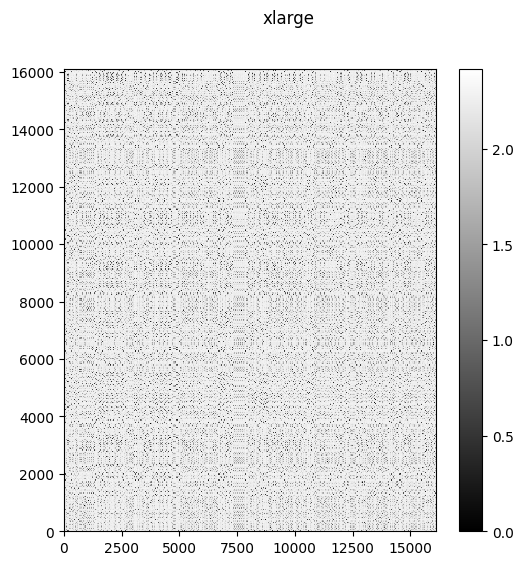

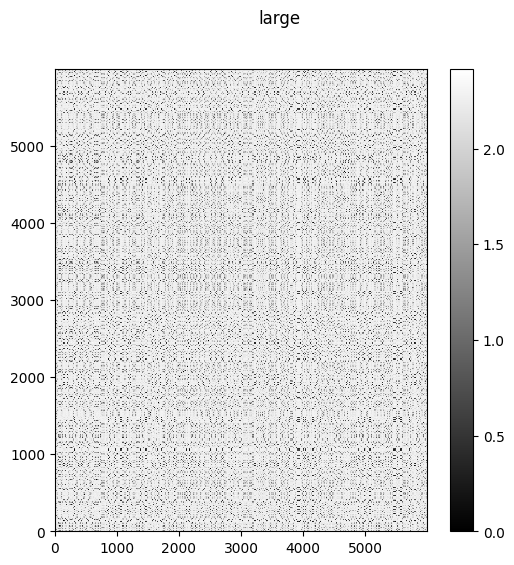

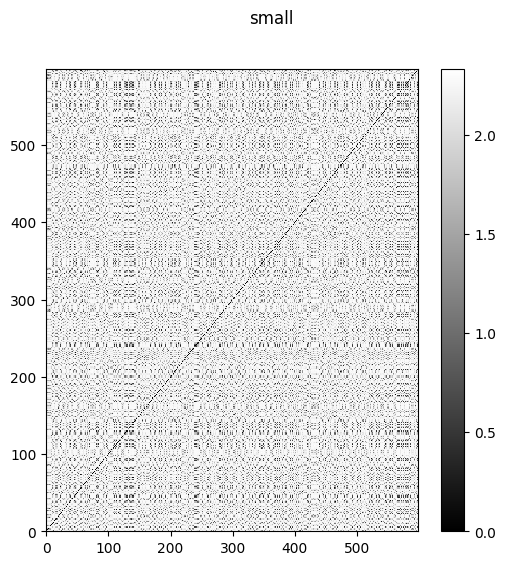

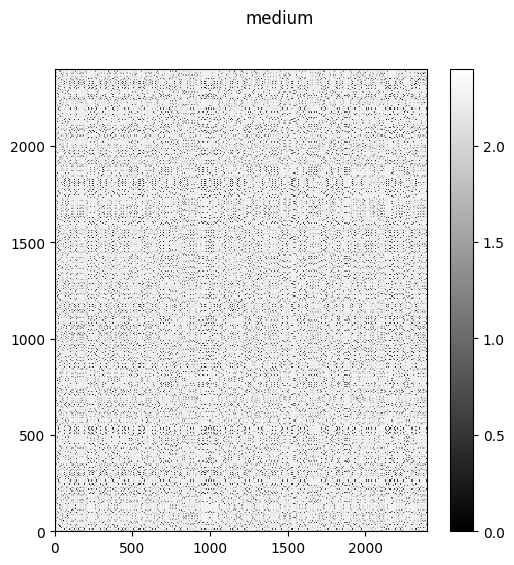

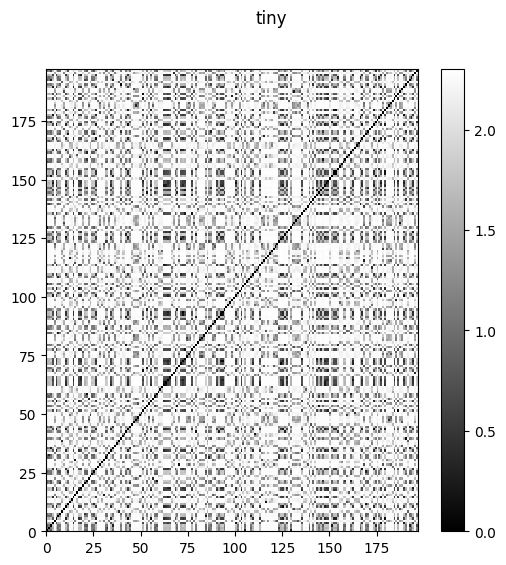

In [13]:
for i, path in enumerate(paths):
    name = path.split('/')[-1][:-4].split('_')[-1]
    matrix = all_raw_matrices[name]
    plt.figure(figsize=(6,6))
    l = plt.pcolormesh(matrix, cmap = 'gray')
    plt.suptitle(name)
    plt.colorbar(l)
    plt.show()

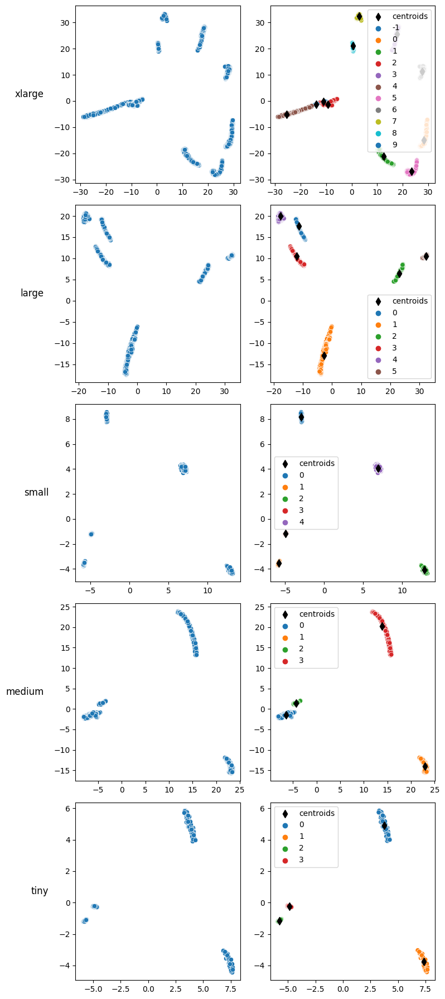

<Figure size 300x300 with 0 Axes>

<Figure size 300x300 with 0 Axes>

<Figure size 300x300 with 0 Axes>

<Figure size 300x300 with 0 Axes>

<Figure size 300x300 with 0 Axes>

In [14]:
fig, axes = plt.subplots(nrows=len(paths), ncols=2, figsize=(8, 18))

for ax, row in zip(axes[:,0], dset_names):
    ax.annotate(row,
                xy=(0, 0.5),
                xytext=(-ax.yaxis.labelpad - pad, 0),
                xycoords=ax.yaxis.label,
                textcoords='offset points',
                size='large',
                ha='right',
                va='center')

for i, path in enumerate(paths):
    name = path.split('/')[-1][:-4].split('_')[-1]
    clusters = all_clusters[name]
    decomposed = all_matrices[name]
    sns.scatterplot(x=decomposed[..., 0], y=decomposed[..., 1], ax=axes[i][0])
    unique_clusters = list(set(clusters))
    centroids = np.empty((len(unique_clusters), 2))
    for j, cluster in enumerate(set(clusters)):
        points_of_cluster = decomposed[clusters==cluster,:]
        centroid = np.mean(points_of_cluster, axis=0) 
        centroids[j] = centroid
    plt.figure(figsize=(3, 3))
    axes[i][1].scatter(centroids[..., 0],
                       centroids[..., 1],
                       marker='d',
                       color='black',
                       label='centroids',
                       s=50,
                       zorder=2)
    sns.scatterplot(x=decomposed[..., 0],
                    y=decomposed[..., 1],
                    hue=clusters,
                    palette="tab10",
                    ax=axes[i][1])

        
fig.tight_layout()
plt.show()

In [39]:
def print_projections_clusters(path):
    """
    Helper function, plots the clusters in three projections, calculated in previos steps from dictionaries.
    param: path - string path to dataset file
    returns: None
    """
    figures = np.load(path)
    clusters = all_clusters[path.split('/')[-1][:-4].split('_')[-1]]

    names = ['A', 'B', 'C', 'D', 'E', 'F', 'G', 'H']

    clusters_unique = set(clusters)
    cnt_clusters = len(clusters_unique)
    fig, ax = plt.subplots(nrows=cnt_clusters, ncols=3, figsize=(15, 2+4*cnt_clusters))
    pad = 5

    for i, cluster in enumerate(set(clusters)):
        ax[i][0].set_xlabel('Axis X')
        ax[i][0].set_ylabel('Axis Y')
        ax[i][1].set_xlabel('Axis X')
        ax[i][1].set_ylabel('Axis Z')
        ax[i][2].set_xlabel('Axis Y')
        ax[i][2].set_ylabel('Axis Z')
        for k in filter(lambda x: clusters[x] == cluster, range(figures.shape[0])):
            ax[i][0].plot(figures[k,...,0], figures[k,...,1], alpha=0.4)
            ax[i][1].plot(figures[k,...,0], figures[k,...,2], alpha=0.4)
            ax[i][2].plot(figures[k,...,1], figures[k,...,2], alpha=0.4)

    for ax, row in zip(ax[:,0], names[:cnt_clusters]):
        ax.annotate('Cluster ' + row,
                    xy=(0, 0.5),
                    xytext=(-ax.yaxis.labelpad - pad, 0),
                    xycoords=ax.yaxis.label,
                    textcoords='offset points',
                    size='large',
                    ha='right',
                    va='center'
                    )

    plt.suptitle(path.split('/')[-1][:-4].split('_')[-1] + '\n', fontsize=16)
    fig.tight_layout()    
    plt.show()

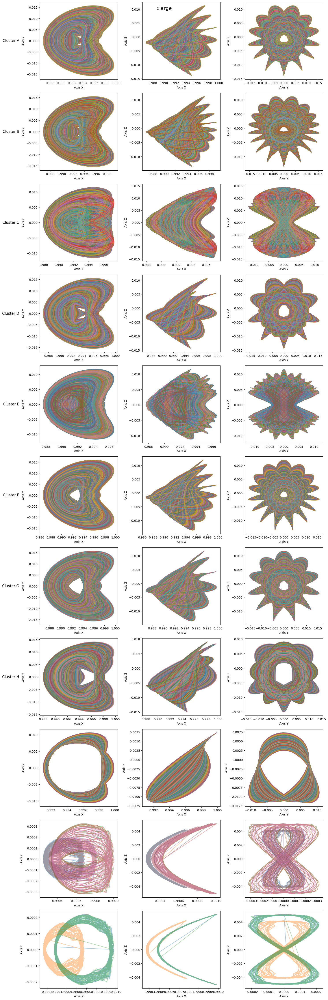

In [40]:
print_projections_clusters(paths[0])

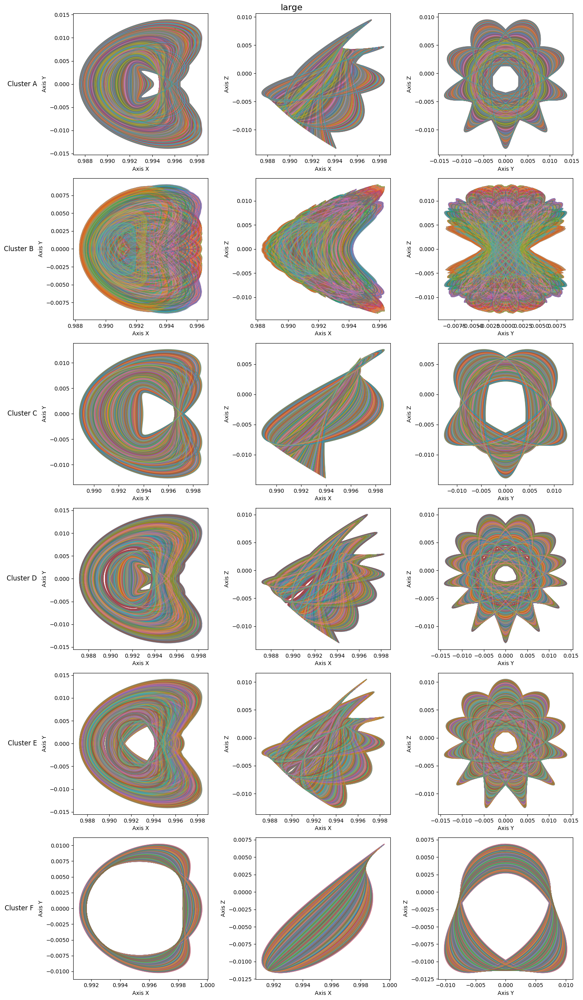

In [41]:
print_projections_clusters(paths[1])

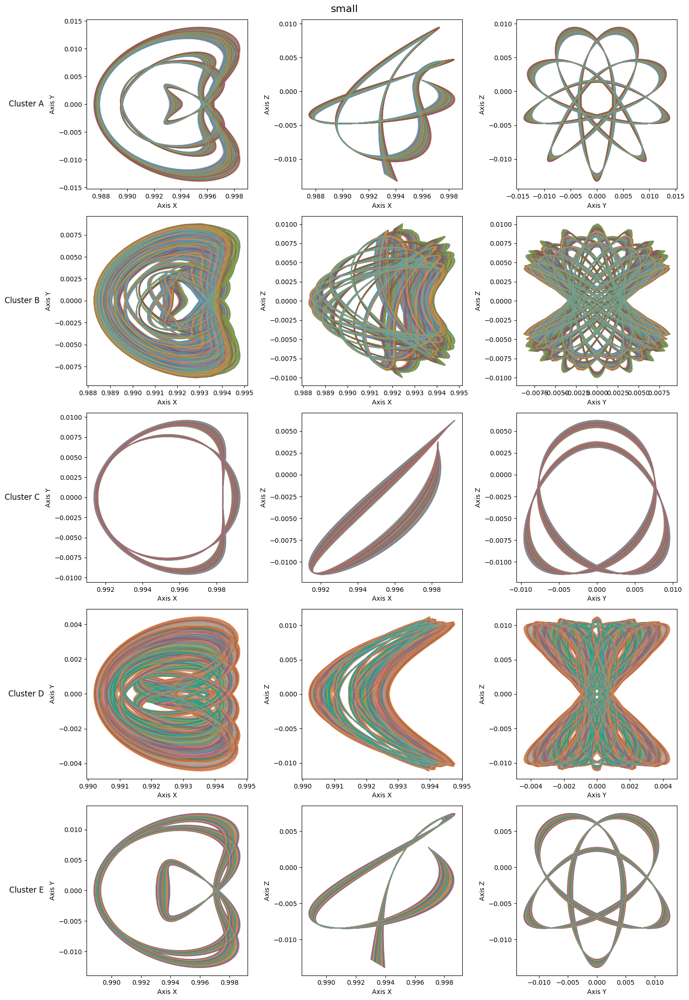

In [42]:
print_projections_clusters(paths[2])

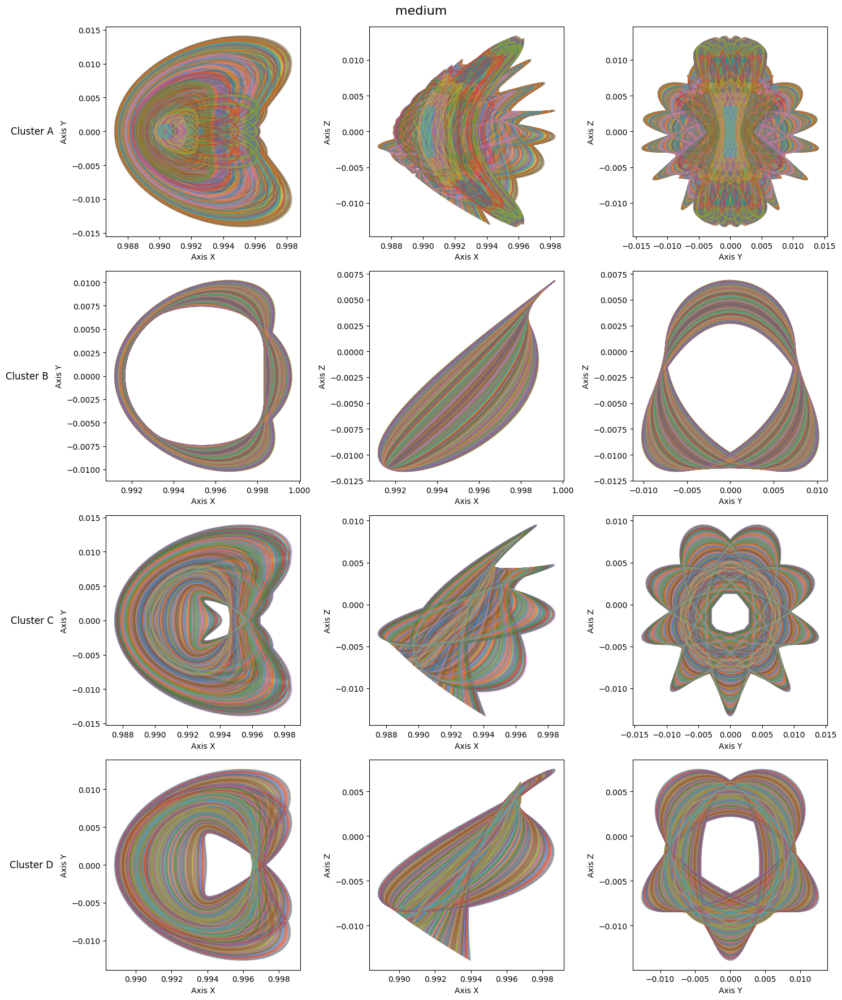

In [43]:
print_projections_clusters(paths[3])

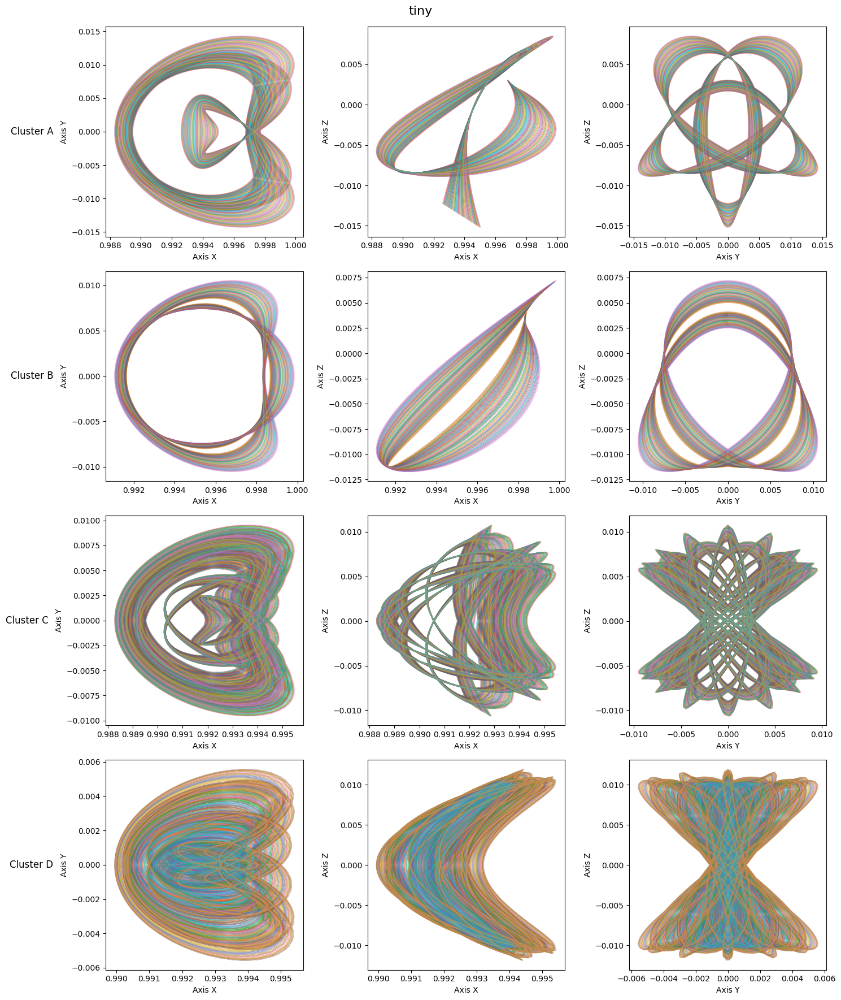

In [44]:
print_projections_clusters(paths[4])